# Annotations using clustering for cells for breast_s1

In [1]:
slide_id = "breast_s1"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_breast_s1.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 107121, 51351), (3, 53560, 25675)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 8) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (892966, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (892966, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (892966, 280)
      └── 'table_nuclei': AnnData (892966, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 892966 × 280
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,121,0,0,121,333.659531,32.331875,cell_labels
1,aaaaaaab-1,63,0,0,63,186.043750,30.390156,cell_labels
2,aaaaaaac-1,35,0,0,35,98.711562,8.489375,cell_labels
3,aaaaaaad-1,93,0,0,93,242.850313,52.652188,cell_labels
4,aaaaaaae-1,131,0,0,131,327.563438,63.173594,cell_labels
...,...,...,...,...,...,...,...,...
892961,aaankacb-1,16,0,0,16,41.950156,17.881875,cell_labels
892962,aaankacc-1,42,0,0,42,217.291875,37.931250,cell_labels
892963,aaankacd-1,105,0,0,105,222.755781,131.224063,cell_labels
892964,aaankace-1,37,0,0,37,52.065156,11.108438,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTG2,ENSG00000163017,Gene Expression,Unknown
ADAM9,ENSG00000168615,Gene Expression,Unknown
ADGRE5,ENSG00000123146,Gene Expression,Unknown
...,...,...,...
VWF,ENSG00000110799,Gene Expression,Unknown
WARS,ENSG00000140105,Gene Expression,Unknown
ZEB1,ENSG00000148516,Gene Expression,Unknown
ZEB2,ENSG00000169554,Gene Expression,Unknown


In [3]:
adata_nuclei = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 757374 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,29.508303,Monocyte,37,1,1,2,1,Fibroblast,CAF,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,28.244812,CREB+MT1A+ vascular smooth muscle cell,22,1,1,2,1,Fibroblast,CAF,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,50.282740,SCGB3A1 mammary luminal progenitor,47,5,6,10,4,Mast,Mast,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,56.647940,CCL19/21 pericyte,43,1,1,2,1,Fibroblast,CAF,normal_cell
aaaaaaag-1,nucleus_boundaries,morpho,aaaaaaag-1,91.058119,Venous EC,97,2,2,6,2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaankabm-1,nucleus_boundaries,morpho,aaankabm-1,24.492701,Macrophage,34,2,2,6,2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaankabn-1,nucleus_boundaries,morpho,aaankabn-1,206.252106,SFN mammary luminal progenitor,258,0,0,1,0,Epithelial,Mammary_luminal_cell,cancer_cell
aaankabo-1,nucleus_boundaries,morpho,aaankabo-1,24.613166,CXCL+ fibroblast,40,0,3,0,0,Epithelial,Mammary_luminal_cell,cancer_cell
aaankacd-1,nucleus_boundaries,morpho,aaankacd-1,127.343219,KRT6B mammary basal cell,61,0,0,1,0,Epithelial,Mammary_luminal_cell,cancer_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.271712,1.146087
ACTA2,2.234773,2.848588
ACTG2,0.473315,1.500599
ADAM9,2.176906,2.683082
ADGRE5,0.547632,1.598777
...,...,...
VWF,0.239251,1.169401
WARS,0.463362,1.481089
ZEB1,0.531600,1.633643
ZEB2,1.389775,2.509948


## 2. Preprocessing

<Axes: >

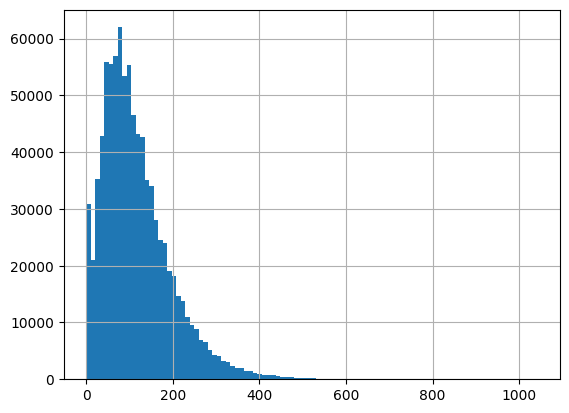

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

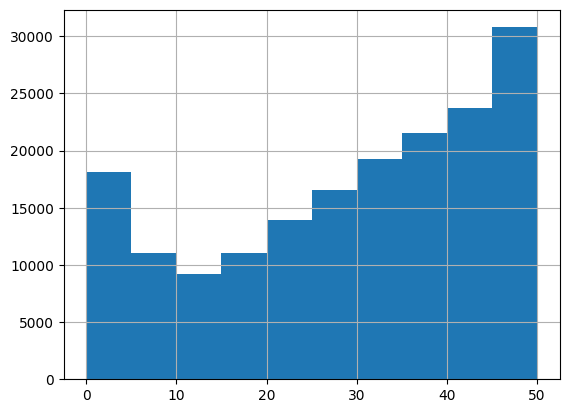

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 49413
Percentage of cells with less than 20 transcripts: 5.53%
-----
Number of cells with less than 15 transcripts: 38381
Percentage of cells with less than 15 transcripts: 4.3%
-----
Number of cells with less than 10 transcripts: 29166
Percentage of cells with less than 10 transcripts: 3.27%
-----
Number total of cells: 892966


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

862045


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


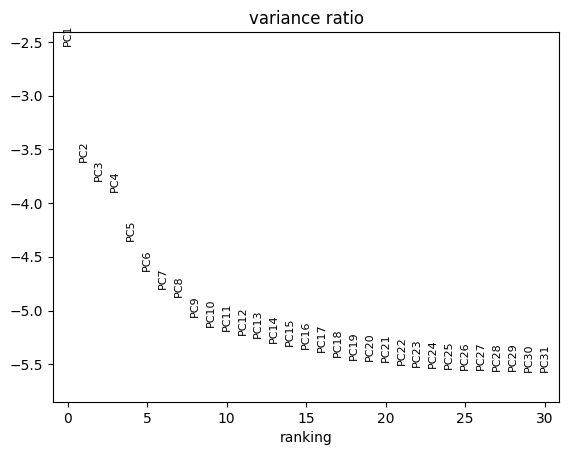

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 862045 × 280
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_1483/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


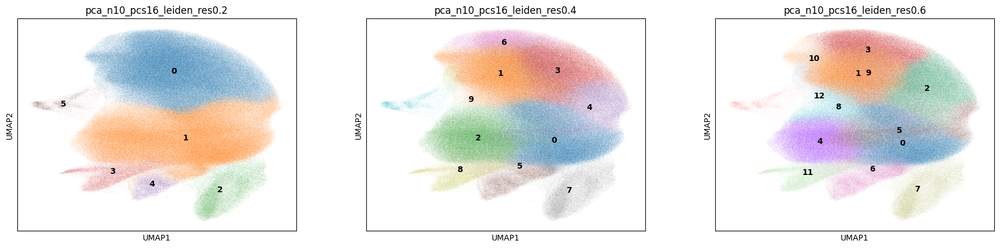

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [42]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['0', '5', '4', '2', '1', '3', '6', '8', '9', '7']
Categories (10, object): ['0', '1', '2', '3', ..., '6', '7', '8', '9']

In [45]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['9']), 'refine_res'] = '9'

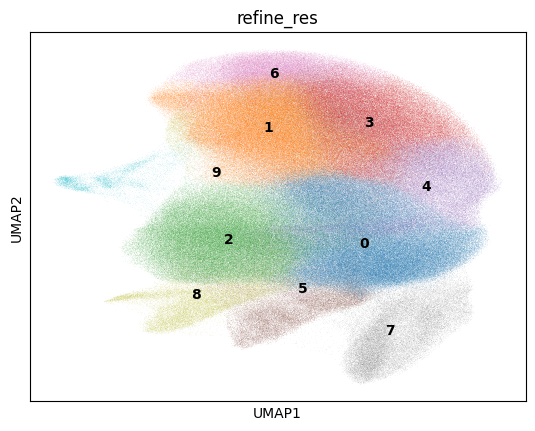

In [46]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [47]:
clustering_label = 'refine_res'

In [48]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

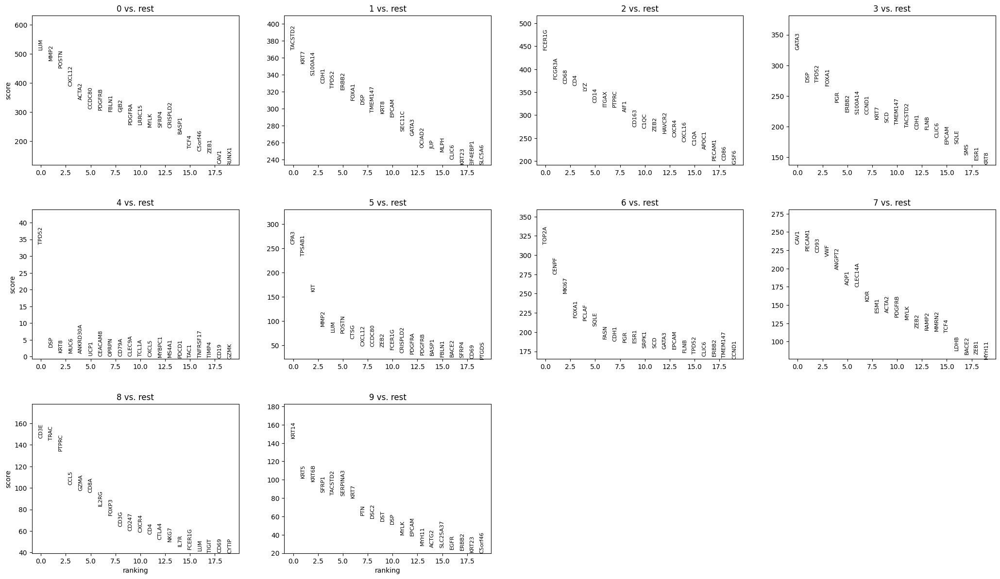

In [49]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [50]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:5, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [51]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [52]:
cluster_id = '0'

In [53]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,74.3
1,NA,NA,NA,14.2
2,Epithelial,Mammary_luminal_cell,cancer_cell,5.7
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,2.5
4,Mast,Mast,normal_cell,2.3


In [54]:
top_ranked_genes[cluster_id]

0       LUM
1      MMP2
2     POSTN
3    CXCL12
4     ACTA2
Name: 0, dtype: object

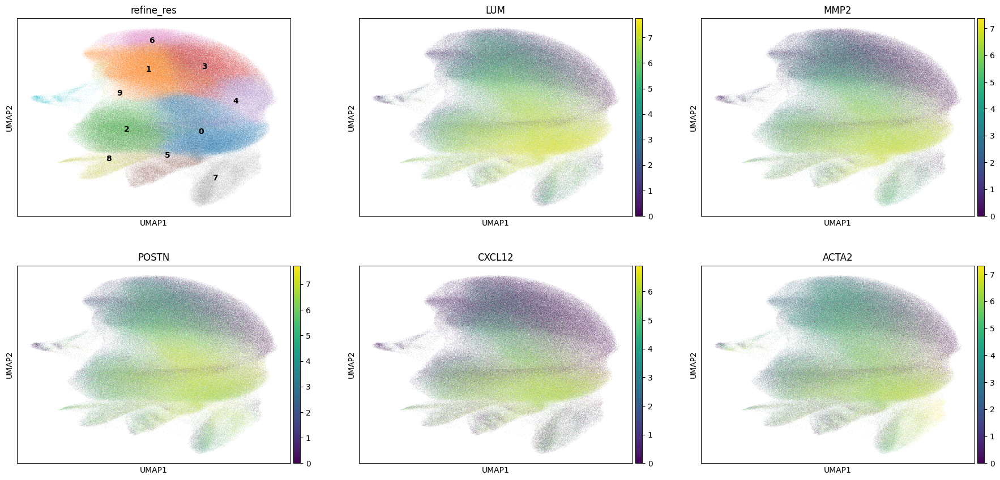

In [55]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [56]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 186540
Percentage of cells in cluster 0: 21.6


In [57]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast/Myofibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.2. Cluster 1

In [58]:
cluster_id = '1'

In [59]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Mammary_luminal_cell,cancer_cell,90.4
1,Epithelial,Mammary_basal_cell_(=myoepithelial),normal_cell,5.5
2,Fibroblast,CAF,normal_cell,2.2
3,NA,NA,NA,1.2
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,0.6


In [60]:
top_ranked_genes[cluster_id]

0    TACSTD2
1       KRT7
2    S100A14
3       CDH1
4      TPD52
Name: 1, dtype: object

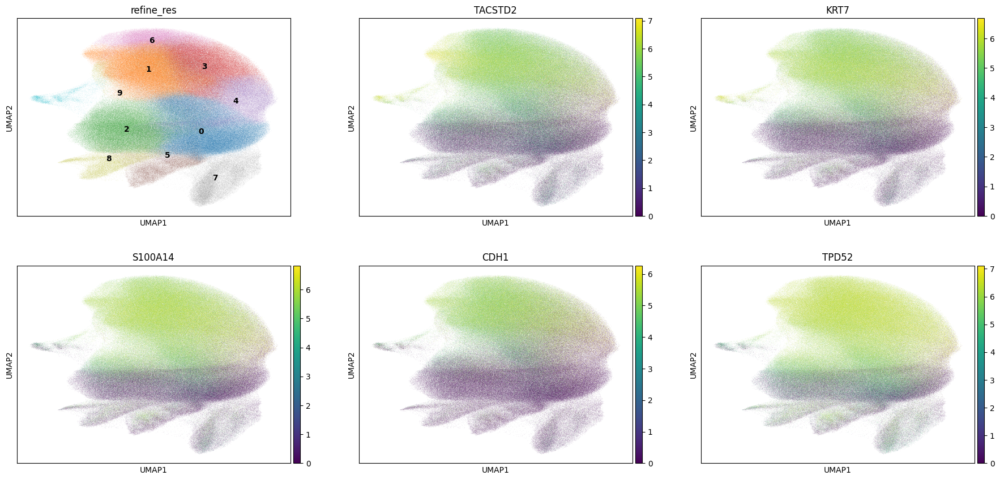

In [61]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [62]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 169061
Percentage of cells in cluster 1: 19.6


In [63]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mammary_luminal_cell'

### 5.3. Cluster 2

In [64]:
cluster_id = '2'

In [65]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,70.6
1,NA,NA,NA,13.7
2,Fibroblast,CAF,normal_cell,11.6
3,Epithelial,Mammary_luminal_cell,cancer_cell,2.9
4,Mast,Mast,normal_cell,0.5


In [66]:
top_ranked_genes[cluster_id]

0    FCER1G
1    FCGR3A
2      CD68
3       CD4
4       LYZ
Name: 2, dtype: object

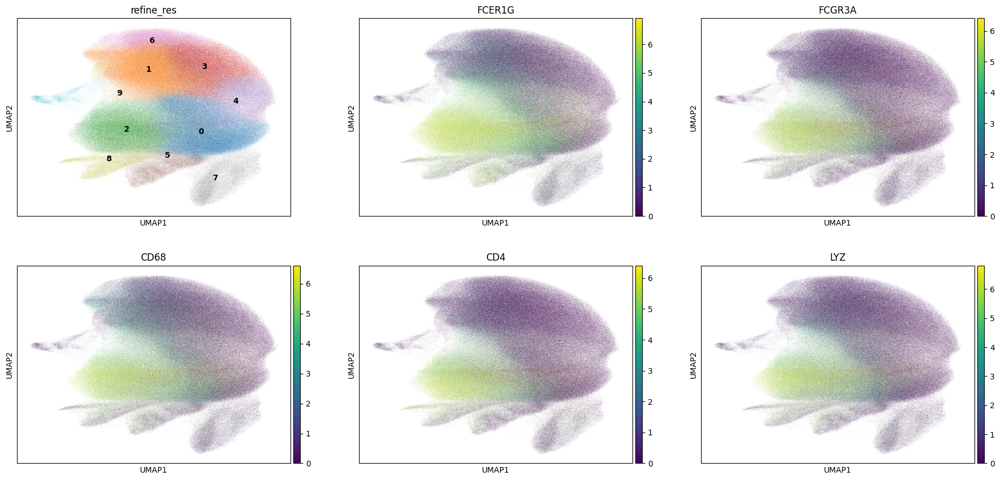

In [67]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [68]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 130494
Percentage of cells in cluster 2: 15.1


In [69]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.4. Cluster 3

In [70]:
cluster_id = '3'

In [71]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Mammary_luminal_cell,cancer_cell,91.1
1,NA,NA,NA,4.4
2,Fibroblast,CAF,normal_cell,2.3
3,Epithelial,Mammary_basal_cell_(=myoepithelial),normal_cell,1.8
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,0.3


In [72]:
top_ranked_genes[cluster_id]

0    GATA3
1      DSP
2    TPD52
3    FOXA1
4      PGR
Name: 3, dtype: object

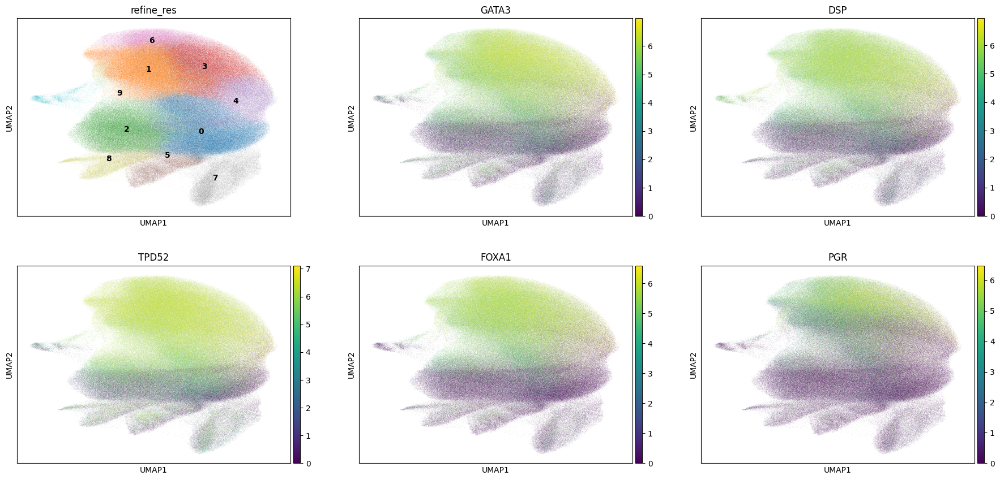

In [73]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [74]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 118787
Percentage of cells in cluster 3: 13.8


In [75]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mammary_luminal_cell'

### 5.5. Cluster 4

In [76]:
cluster_id = '4'

In [77]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,48.4
1,Epithelial,Mammary_luminal_cell,cancer_cell,38.3
2,Fibroblast,CAF,normal_cell,6.6
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,5.5
4,Epithelial,Mammary_basal_cell_(=myoepithelial),normal_cell,0.6


In [78]:
top_ranked_genes[cluster_id]

0       TPD52
1         DSP
2        KRT8
3        MUC6
4    ANKRD30A
Name: 4, dtype: object

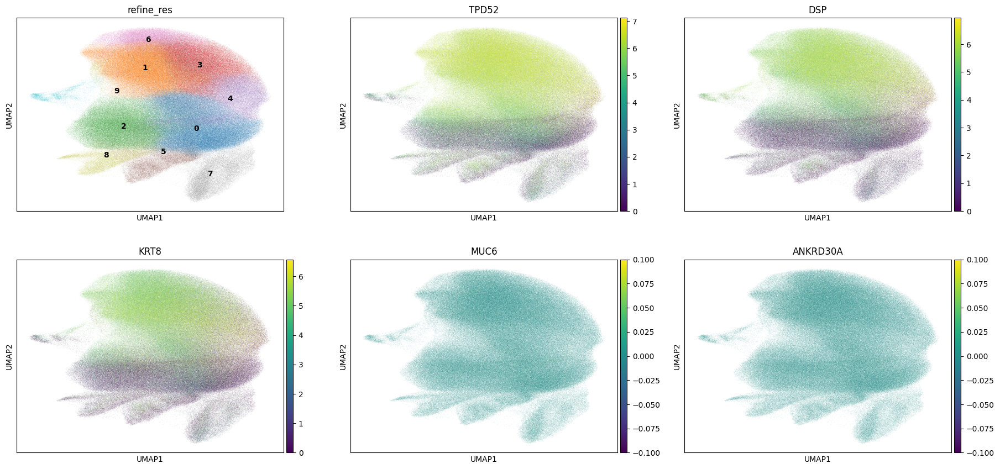

In [79]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [80]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 67074
Percentage of cells in cluster 4: 7.8


In [81]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mammary_luminal_cell'

### 5.6. Cluster 5

In [82]:
cluster_id = '5'

In [83]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Mast,Mast,normal_cell,31.5
1,Epithelial,Mammary_luminal_cell,cancer_cell,22.5
2,NA,NA,NA,19.0
3,Fibroblast,CAF,normal_cell,18.3
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,8.0


In [84]:
top_ranked_genes[cluster_id]

0      CPA3
1    TPSAB1
2       KIT
3      MMP2
4       LUM
Name: 5, dtype: object

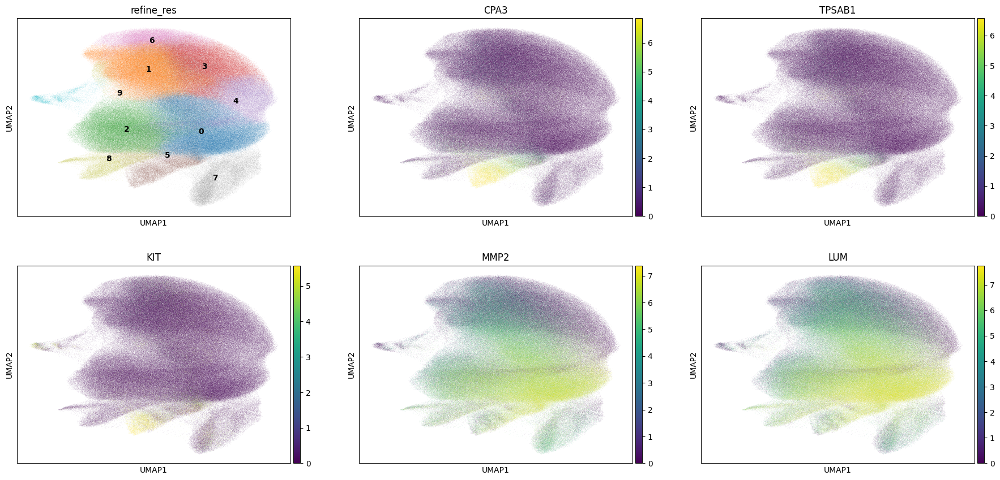

In [85]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [86]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 57006
Percentage of cells in cluster 5: 6.6


In [87]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.7. Cluster 6

In [88]:
cluster_id = '6'

In [89]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Mammary_luminal_cell,cancer_cell,93.9
1,Epithelial,Mammary_basal_cell_(=myoepithelial),normal_cell,4.9
2,Fibroblast,CAF,normal_cell,0.6
3,NA,NA,NA,0.3
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,0.1


In [90]:
top_ranked_genes[cluster_id]

0    TOP2A
1    CENPF
2    MKI67
3    FOXA1
4    PCLAF
Name: 6, dtype: object

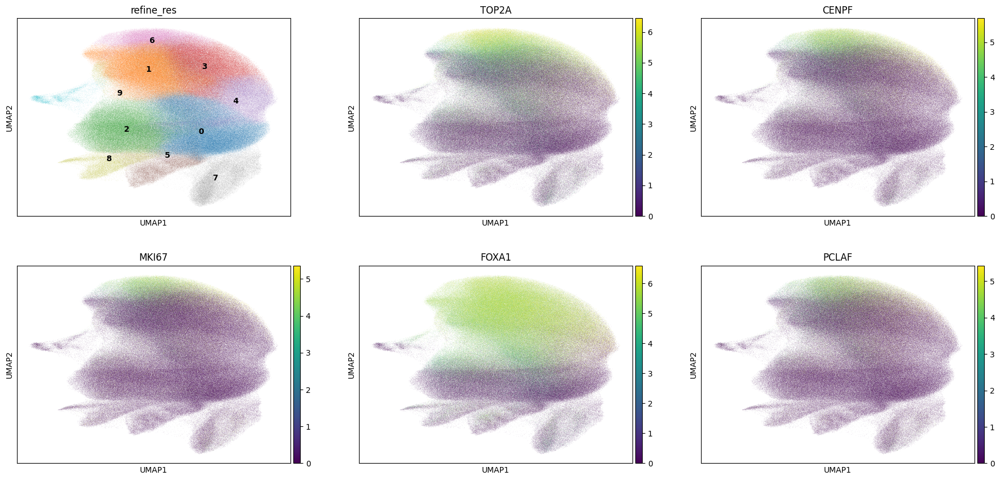

In [91]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [92]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 51069
Percentage of cells in cluster 6: 5.9


In [93]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_mammary_luminal_cell'

### 5.8. Cluster 7

In [94]:
cluster_id = '7'

In [95]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,73.4
1,NA,NA,NA,10.2
2,Fibroblast,CAF,normal_cell,9.4
3,Epithelial,Mammary_luminal_cell,cancer_cell,3.0
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,2.5


In [96]:
top_ranked_genes[cluster_id]

0      CAV1
1    PECAM1
2      CD93
3       VWF
4    ANGPT2
Name: 7, dtype: object

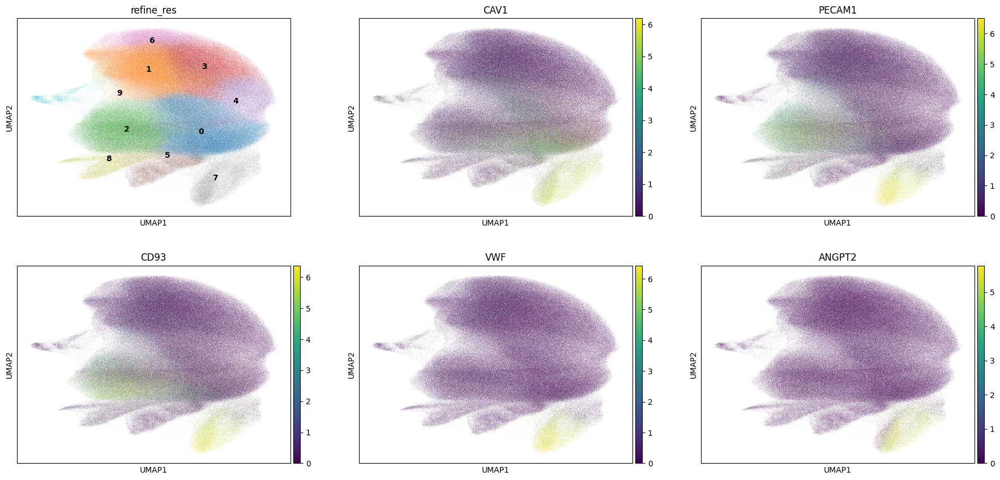

In [97]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [98]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 38071
Percentage of cells in cluster 7: 4.4


In [99]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Angiogenic_endothelial_cell'

### 5.9. Cluster 8

In [100]:
cluster_id = '8'

In [101]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,50.5
1,Epithelial,Mammary_luminal_cell,cancer_cell,16.2
2,NA,NA,NA,15.7
3,Fibroblast,CAF,normal_cell,8.1
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,8.0


In [102]:
top_ranked_genes[cluster_id]

0     CD3E
1     TRAC
2    PTPRC
3     CCL5
4     GZMA
Name: 8, dtype: object

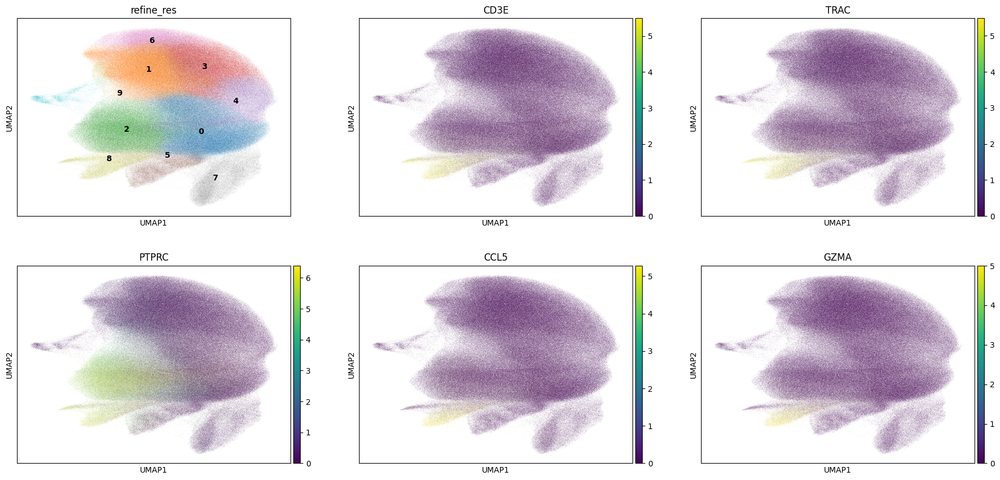

In [103]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [104]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 29187
Percentage of cells in cluster 8: 3.4


In [105]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.10. Cluster 9

In [106]:
cluster_id = '9'

In [107]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Mammary_basal_cell_(=myoepithelial),normal_cell,63.7
1,Epithelial,Mammary_luminal_cell,cancer_cell,19.3
2,NA,NA,NA,9.5
3,Fibroblast,CAF,normal_cell,3.7
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,2.9


In [108]:
top_ranked_genes[cluster_id]

0      KRT14
1       KRT5
2      KRT6B
3      SFRP1
4    TACSTD2
Name: 9, dtype: object

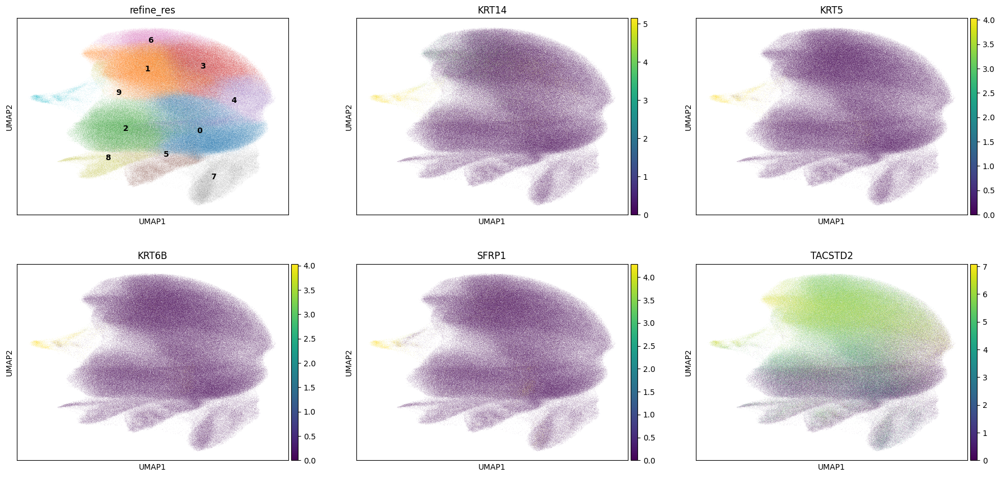

In [109]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [110]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 14756
Percentage of cells in cluster 9: 1.7


In [112]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mammary_basal_cell_(=myoepithelial)'

## 6. Cancer cells

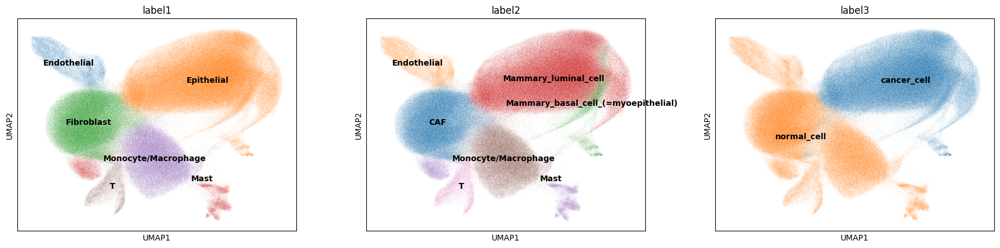

In [4]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

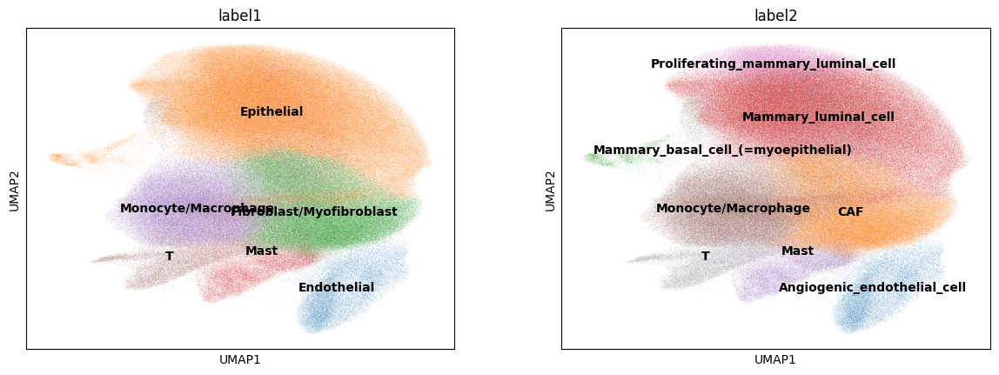

In [116]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [117]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'].isin(['Epithelial']), 'label3'] = 'cancer_cell'

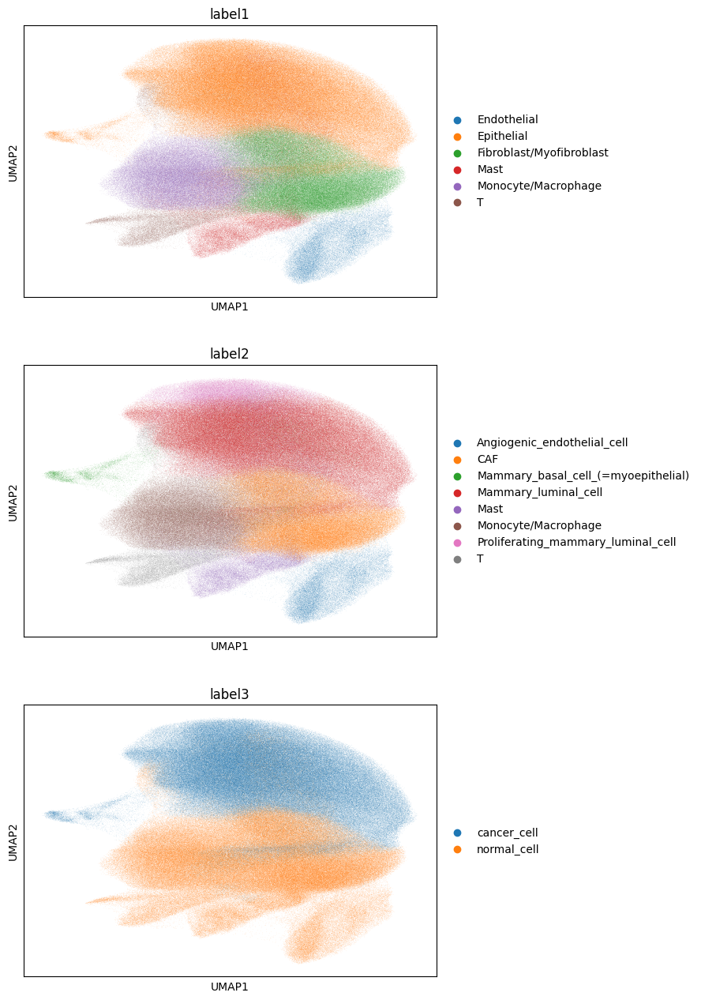

In [118]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [119]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,121,0,0,121,333.659531,32.331875,cell_labels,1,0,6,0,Fibroblast/Myofibroblast,CAF,normal_cell
1,aaaaaaab-1,63,0,0,63,186.043750,30.390156,cell_labels,1,0,0,0,Fibroblast/Myofibroblast,CAF,normal_cell
2,aaaaaaac-1,35,0,0,35,98.711562,8.489375,cell_labels,1,0,0,0,Fibroblast/Myofibroblast,CAF,normal_cell
3,aaaaaaad-1,93,0,0,93,242.850313,52.652188,cell_labels,1,5,6,5,Mast,Mast,normal_cell
4,aaaaaaae-1,131,0,0,131,327.563438,63.173594,cell_labels,1,0,0,0,Fibroblast/Myofibroblast,CAF,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
892961,aaankacb-1,16,0,0,16,41.950156,17.881875,cell_labels,1,4,5,4,Epithelial,Mammary_luminal_cell,cancer_cell
892962,aaankacc-1,42,0,0,42,217.291875,37.931250,cell_labels,0,4,2,4,Epithelial,Mammary_luminal_cell,cancer_cell
892963,aaankacd-1,105,0,0,105,222.755781,131.224063,cell_labels,0,1,3,1,Epithelial,Mammary_luminal_cell,cancer_cell
892964,aaankace-1,37,0,0,37,52.065156,11.108438,cell_labels,0,4,2,4,Epithelial,Mammary_luminal_cell,cancer_cell


In [120]:
adata_cells.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")